# Custom Training with YOLOv5

In this tutorial, we assemble a dataset and train a custom YOLOv5 model to recognize the objects in our dataset. To do so we will take the following steps:

* Gather a dataset of images and label our dataset
* Export our dataset to YOLOv5
* Train YOLOv5 to recognize the objects in our dataset
* Evaluate our YOLOv5 model's performance
* Run test inference to view our model at work



![](https://uploads-ssl.webflow.com/5f6bc60e665f54545a1e52a5/615627e5824c9c6195abfda9_computer-vision-cycle.png)

# Step 1: Install Requirements

In [2]:
#clone YOLOv5 and
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 16734, done.
remote: Counting objects: 100% (275/275), done.
remote: Compressing objects: 100% (199/199), done.
remote: Total 16734 (delta 146), reused 158 (delta 76), pack-reused 16459
Receiving objects: 100% (16734/16734), 15.41 MiB | 15.91 MiB/s, done.
Resolving deltas: 100% (11449/11449), done.
/content/yolov5/yolov5
Setup complete. Using torch 2.3.0+cu121 (Tesla T4)


# Step 2: Assemble Our Dataset

In order to train our custom model, we need to assemble a dataset of representative images with bounding box annotations around the objects that we want to detect. And we need our dataset to be in YOLOv5 format.

In Roboflow, you can choose between two paths:

* Convert an existing dataset to YOLOv5 format. Roboflow supports over [30 formats object detection formats](https://roboflow.com/formats) for conversion.
* Upload raw images and annotate them in Roboflow with [Roboflow Annotate](https://docs.roboflow.com/annotate).

# Annotate

![](https://roboflow-darknet.s3.us-east-2.amazonaws.com/roboflow-annotate.gif)

# Version

![](https://roboflow-darknet.s3.us-east-2.amazonaws.com/robolfow-preprocessing.png)


In [3]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [4]:
from roboflow import Roboflow
rf = Roboflow(api_key="15FinU51sOE6jh5pdlS6")
project = rf.workspace("minh-ld18876-sinhvien-hoasen-edu-vn").project("nhau-mon-emt")
version = project.version(1)
dataset = version.download("yolov5")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to /content/datasets/Nhậu-môn-EmT-1 in yolov5pytorch:: 100%|██████████| 250/250 [00:00<00:00, 5098.84it/s]


# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [5]:
!python train.py --img 600 --batch 16 --epochs 4000 --data /content/datasets/Nhậu-môn-EmT-1/data.yaml --weights yolov5s.pt

2024-07-05 18:08:06.007413: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-05 18:08:06.007469: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-05 18:08:06.048360: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/datasets/Nhậu-môn-EmT-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=4000, batch_size=16, imgsz=600, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_s

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [6]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [16]:
! curl "https://raw.githubusercontent.com/AdTekDev/EmT.DS/main/EmT%20Test%2002/SET06.zip" > /content/SET06.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 10.3M  100 10.3M    0     0  18.6M      0 --:--:-- --:--:-- --:--:-- 18.6M


In [18]:
!unzip /content/SET06.zip

Archive:  /content/SET06.zip
replace SET06/H-087.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-087.jpg         
replace SET06/H-088.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-088.png         
replace SET06/H-089.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-089.jpg         
replace SET06/H-090.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-090.jpg         
replace SET06/H-091.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-091.jpg         
replace SET06/H-092.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-092.jpg         
replace SET06/H-093.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-093.jpg         
replace SET06/H-094.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-094.jpg         
replace SET06/H-095.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: SET06/H-095.jpg         
replace SET06/H-096.jpeg? [y]es, [n]o, [A]ll

In [22]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 600 --conf 0.1 --source /content/yolov5/yolov5/SET06

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/yolov5/SET06, data=data/coco128.yaml, imgsz=[600, 600], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-335-g40f490d9 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7716739 parameters, 0 gradients, 18.0 GFLOPs
WARNING ⚠️ --img-size [600, 600] must be multiple of max stride 32, updating to [608, 608]
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/27 /content/yolov5/yolov5/SET06/H-087.jpg: 480x608 2 chas, 1 ga luoc, 1 goi, 1 la ghim, 7 nuoc cam eps, 1 ruou, 1 strong bow, 71.0ms
image 2/27 /content/yolov5/yolov5/SET06/H-088.p

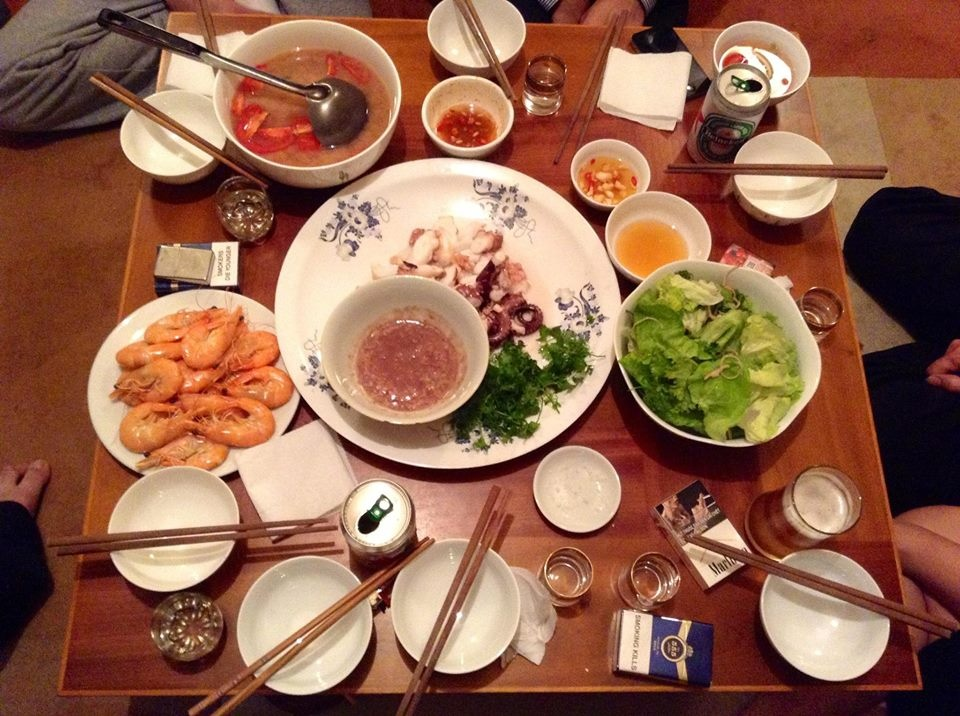

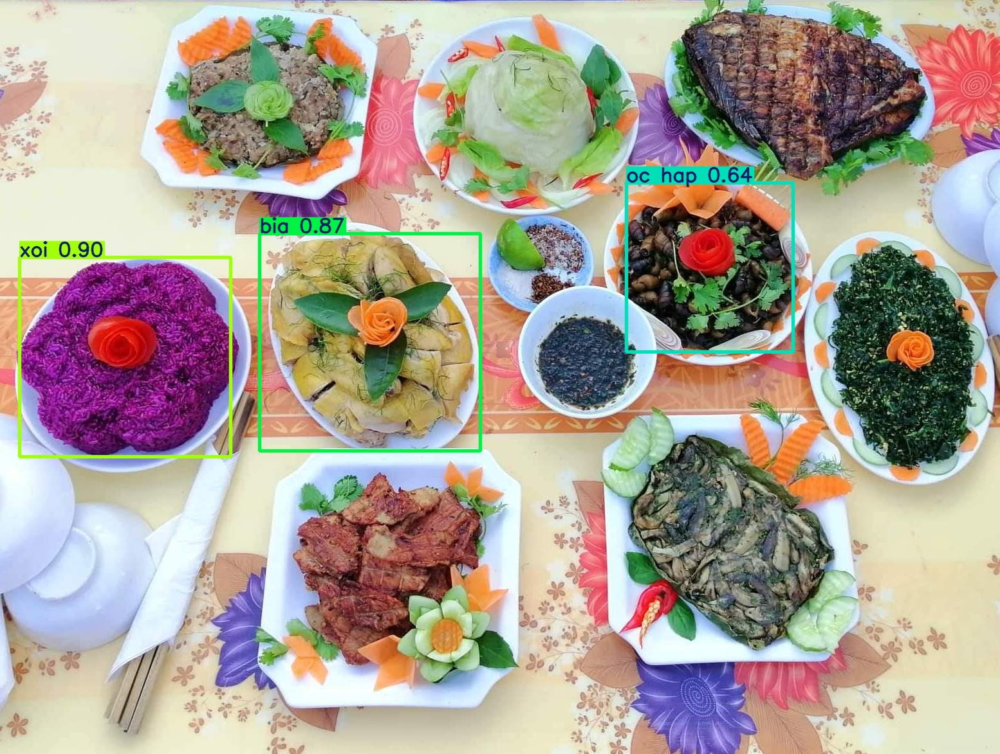

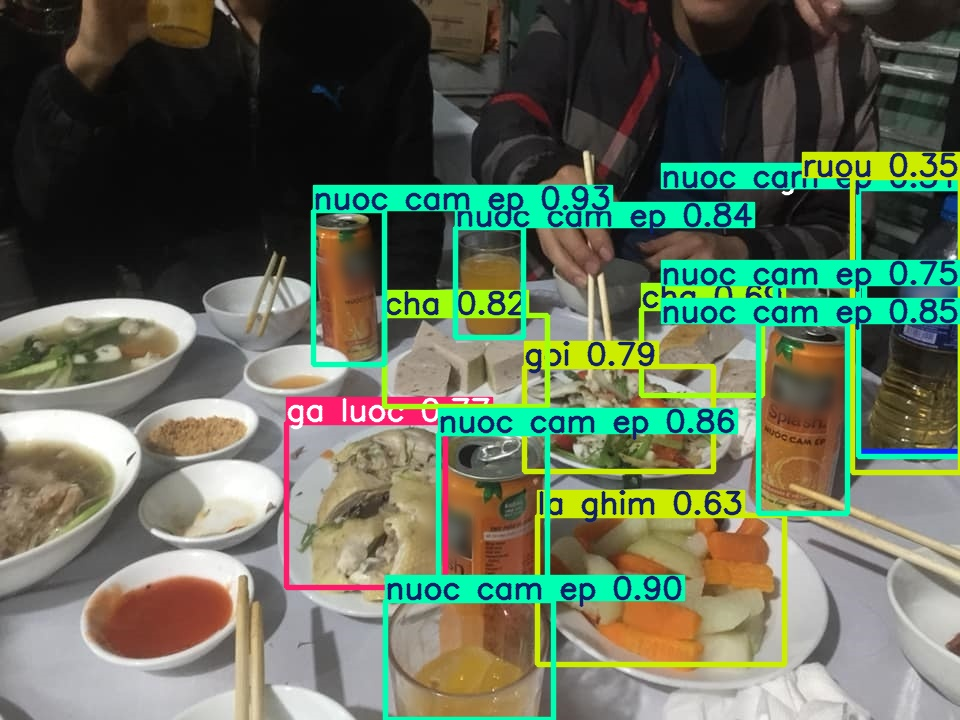

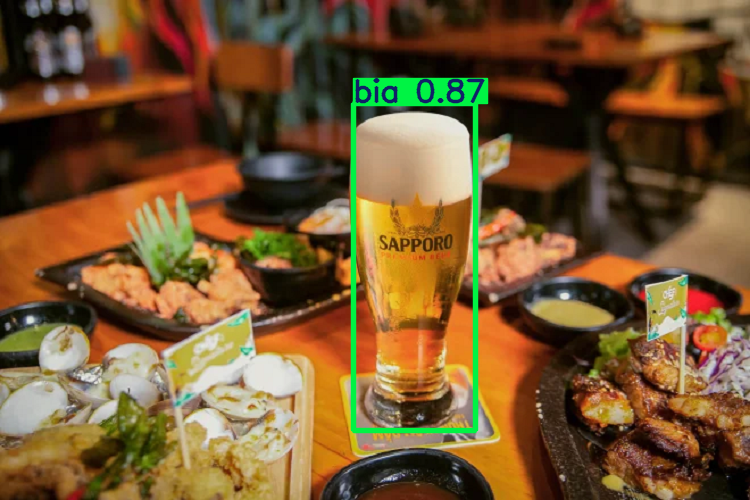

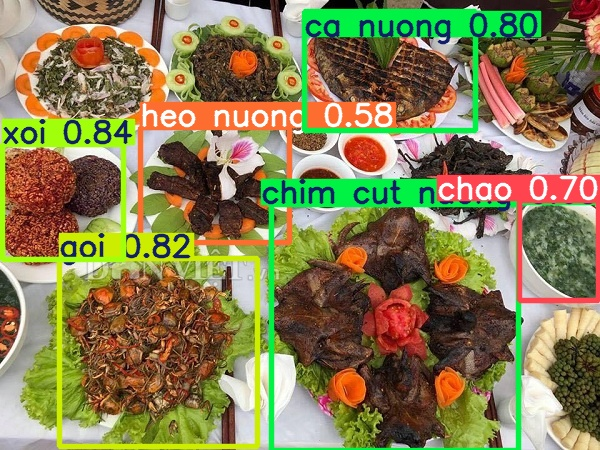

...

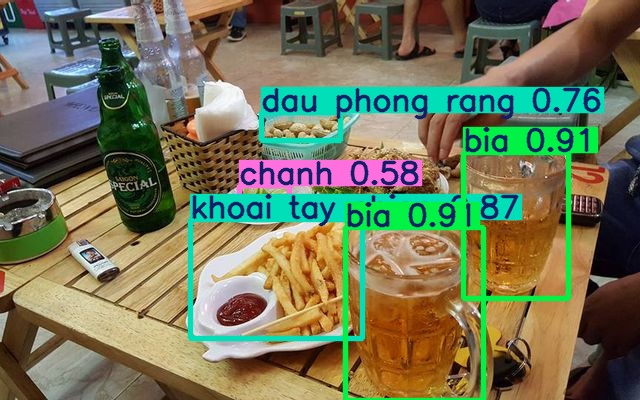

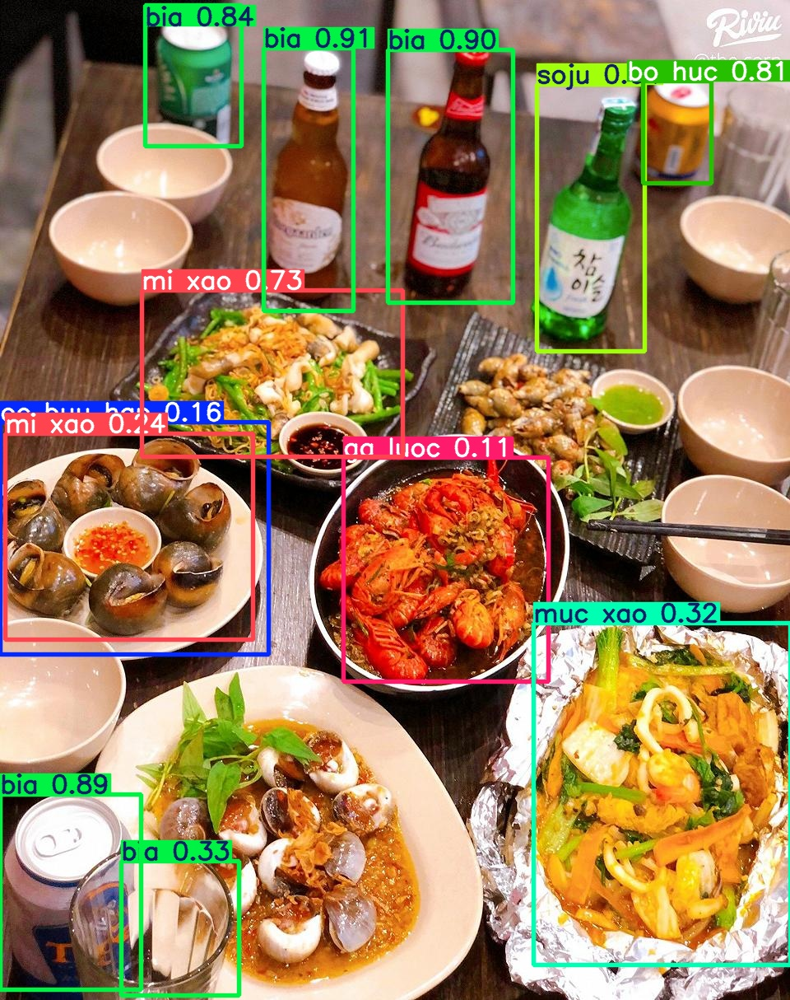

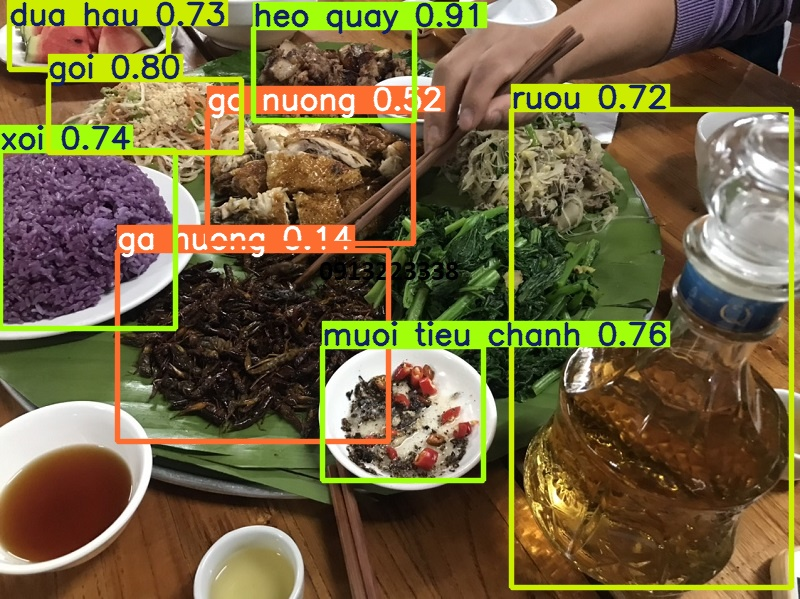

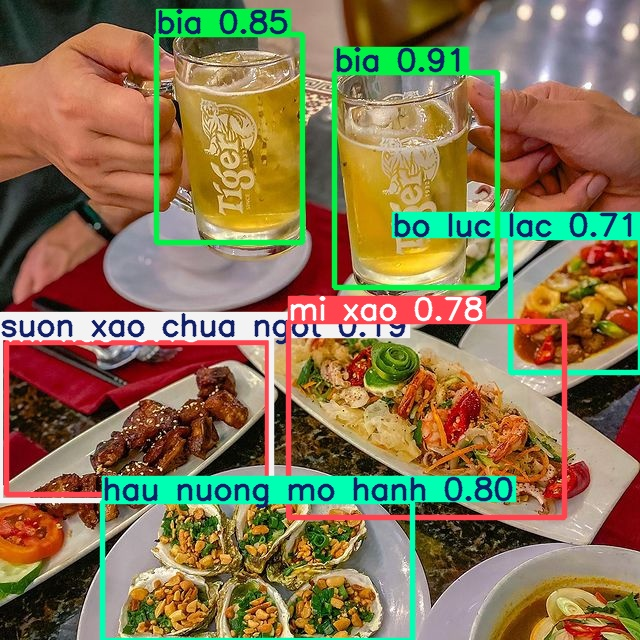

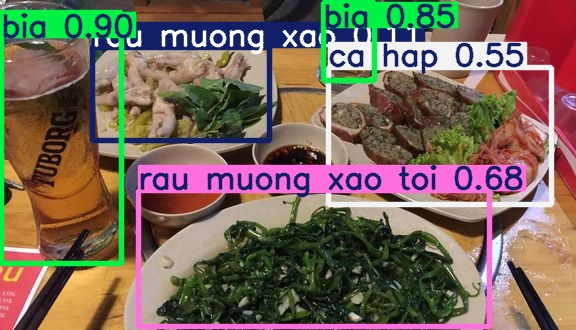

In [23]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/yolov5/runs/detect/exp2/*'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [21]:
!zip -r /content/model.zip /content/yolov5

  adding: content/yolov5/ (stored 0%)
  adding: content/yolov5/.gitignore (deflated 55%)
  adding: content/yolov5/hubconf.py (deflated 74%)
  adding: content/yolov5/.dockerignore (deflated 56%)
  adding: content/yolov5/data/ (stored 0%)
  adding: content/yolov5/data/Argoverse.yaml (deflated 55%)
  adding: content/yolov5/data/SKU-110K.yaml (deflated 52%)
  adding: content/yolov5/data/VisDrone.yaml (deflated 58%)
  adding: content/yolov5/data/ImageNet1000.yaml (deflated 54%)
  adding: content/yolov5/data/xView.yaml (deflated 57%)
  adding: content/yolov5/data/coco.yaml (deflated 49%)
  adding: content/yolov5/data/ImageNet10.yaml (deflated 42%)
  adding: content/yolov5/data/Objects365.yaml (deflated 53%)
  adding: content/yolov5/data/VOC.yaml (deflated 55%)
  adding: content/yolov5/data/GlobalWheat2020.yaml (deflated 54%)
  adding: content/yolov5/data/scripts/ (stored 0%)
  adding: content/yolov5/data/scripts/get_coco128.sh (deflated 36%)
  adding: content/yolov5/data/scripts/get_imagenet